In [1]:
!nvidia-smi

Sun Sep 14 13:10:27 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.127.05             Driver Version: 550.127.05     CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA H100 80GB HBM3          On  |   00000000:1B:00.0 Off |                    0 |
| N/A   30C    P0            117W /  700W |    1683MiB /  81559MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
!nvcc --version

try:
    import google.colab
    _ON_COLAB = True
except:
    _ON_COLAB = False

print('Running on Google Colab = ', _ON_COLAB)
import os
import torch
from IPython import get_ipython
import os
# Definir o caminho base
if _ON_COLAB:
    BASE_PATH = "/content"
    import locale
    locale.getpreferredencoding = lambda: "UTF-8"
else:
    BASE_PATH = "/lapix/compartilhado/beatriz/placenta/resnet" # trocar para o base path do seu computador se estiver rodando localmente, deixar /lapix se estiver rodando nos conteiners lapix
    VISIBLE_GPUS = [2] # Selecionar a GPU PARA RODAR! VER QUAL ESTA LIVRE

    if torch.cuda.device_count() != 8:
        print("GPU SETADA - PULANDO ETAPA")
    else:
        os.environ["CUDA_VISIBLE_DEVICES"] = str(VISIBLE_GPUS).replace("]", "").replace("[","").replace(" ", "")
        os.environ["NVIDIA_VISIBLE_DEVICES"] = str(VISIBLE_GPUS).replace("]", "").replace("[","").replace(" ", "")
        print("CUDA GPUS NUMBER: ", torch.cuda.device_count())
    
os.chdir(BASE_PATH) # garantir que está executando no caminho base definido

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Mar_28_02:18:24_PDT_2024
Cuda compilation tools, release 12.4, V12.4.131
Build cuda_12.4.r12.4/compiler.34097967_0
Running on Google Colab =  False
CUDA GPUS NUMBER:  1


# Suprimir Avisos Gerais na saida do notebook
Suprimir apenas "avisos", erros irá mostrar a causar e efetuará a parada do notebook normalmente.

In [3]:

import warnings
warnings.filterwarnings('ignore')


# Instalação e verificação das bibliotecas

Instalação das bibliotecas necessárias para rodar e avaliar o modelo implementado neste notebook.

In [4]:
INSTALL_LIBS = False # Setar para True para instalar localmente também (Não é necessário se estiver rodando nos conteiners Lapix)

if _ON_COLAB:
    INSTALL_LIBS = True

if INSTALL_LIBS:
    !pip install lapixdl
    !pip install -U albumentations
    !pip install fastai
    !pip install wandb -qU

# OPCIONAL: Utilizar WandB
*   Software para visualizar métricas e compara-los entre experimentos.
*   https://wandb.ai/site
*   Obs: Necessário criar uma conta e gerar um token de acesso.

CASO NÃO QUEIRA USAR WANDB, NÃO EXECUTE ESTA CELULA. IRÁ TRAVAR O PROCESSO ATÉ SER INSERIDO UMA CHAVE VÁLIDA.


In [5]:
# Log in to your W&B account
import wandb
wandb.login()
!wandb enabled

wandb: ERROR Failed to detect the name of this notebook. You can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: belopes (belopes-universidade-federal-de-santa-catarina) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


W&B enabled.


# Carregar as bibliotecas
Realiza o import das bibliotecas básicas do notebook

In [6]:
from pathlib import Path
import fnmatch
import random
import os
import shutil
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd


from fastai.vision.all import *
from fastai.callback.wandb import *


import cv2

from lapixdl.evaluation.visualize import show_segmentations
from lapixdl.evaluation.model import Result, Mask


# Importar Road Traversing Knowledge (RTK) Dataset

Este conjunto de dados contém estradas com diferentes tipos de superfície: variações de asfalto, outros tipos de pavimento e até estradas não pavimentadas. Contém também situações com danos na estrada (ex.: buracos). As imagens foram capturadas em um veículo em movimento nas cidades de Águas Mornas e Santo Amaro da Imperatriz, vizinhas de Florianópolis, no estado de Santa Catarina, Brasil. Também fazemos grande parte dos quadros separados por suas classes, como dados de teste.



In [ ]:
'''import os
# Download do dataset RTK pelo Mendeley
file_link = "https://data.mendeley.com/public-files/datasets/hssswvmjwf/files/2c72e75d-1f50-457a-86f0-a5e3a4174df9/file_downloaded"
!wget $file_link

os.rename(os.path.join(BASE_PATH, "file_downloaded"), os.path.join(BASE_PATH, "file_downloaded.zip"))
!unzip -qq -u file_downloaded.zip
!rm file_downloaded.zip

In [ ]:
'''# Extraindo o conjunto de Dados .zip

import zipfile
import os

# Caminho do arquivo zip e pasta de extração 
dataset_zip = '/lapix/compartilhado/beatriz/dataset.zip'
extract_path = '/lapix/compartilhado/beatriz/datasetv1'

# Verificar e extrair o arquivo
if os.path.exists(dataset_zip):
    with zipfile.ZipFile(dataset_zip, 'r') as zip_ref:
        zip_ref.extractall(extract_path)
    print(f"Dataset extraído em: {extract_path}")
else:
    print(f"Arquivo '{dataset_zip}' não encontrado!")

In [9]:
'''# SEPARAR AS IMAGENS E MÁSCARAS DO DATASET EM PASTAS DIFERENTES

import os
import shutil

# Define source directory (where the images are located)
source_dir = "/lapix/compartilhado/beatriz/datasetv1/train"  # Change this if necessary

# Define destination directories
label_dir = os.path.join(source_dir, "label")
images_dir = os.path.join(source_dir, "images")

# Create directories if they don’t exist
os.makedirs(label_dir, exist_ok=True)
os.makedirs(images_dir, exist_ok=True)

# Move images
for file in os.listdir(source_dir):
    if file.endswith(".png"):
        shutil.move(os.path.join(source_dir, file), os.path.join(label_dir, file))
    elif file.endswith(".jpg"):
        shutil.move(os.path.join(source_dir, file), os.path.join(images_dir, file))

print("Images sorted successfully!")

Images sorted successfully!


# Selecionamos a Rede Neural


*   resnet18, resnet34, resnet50, resnet101, resnet152
*   squeezenet1_0, squeezenet1_1
*   densenet121, densenet169, densenet201, densenet161
*   vgg16_bn, vgg19_bn
*   alexnet

Obs: Temos que alterar o import e o used model

# Resnet

ResNet é um modelo proposto em 2015 por pesquisadores da Microsoft Research que introduziu uma nova arquitetura chamada Rede Residual.

Para resolver o problema do vanishing/exploding gradient, esta arquitetura introduziu o conceito denominado Blocos Residuais. Nesta rede, usamos uma técnica chamada de skip conections. A skip connection conecta as ativações de uma camada a outras camadas, pulando algumas camadas entre elas. Isso forma um bloco residual. Resnets são feitas empilhando esses blocos residuais juntos.
A abordagem por trás dessa rede é, em vez de camadas aprenderem o mapeamento subjacente, permitimos que a rede se ajuste ao mapeamento residual

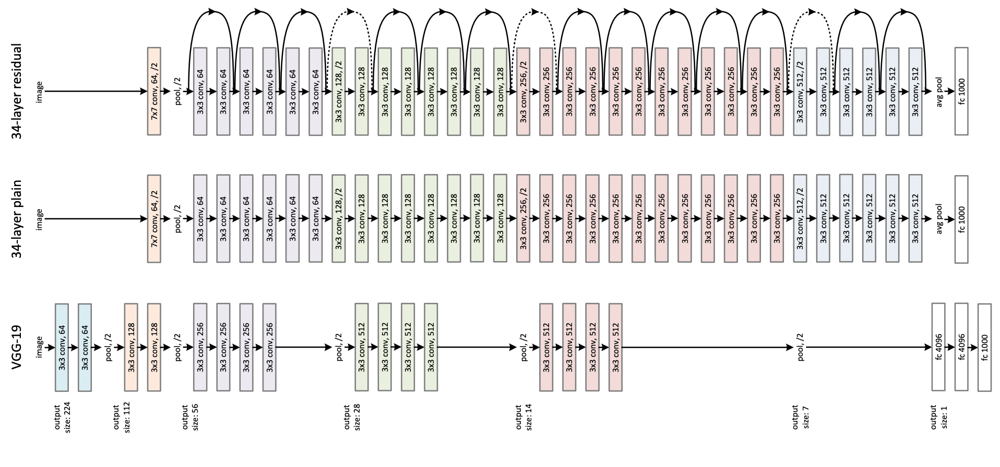



In [7]:
# Definir o modelo de backbone ResNet
from fastai.vision.models import resnet18, resnet34, resnet50
used_model = resnet152

In [8]:
dataset_root = os.path.join(BASE_PATH, 'dataset') # caminho base do dataset
OUTPUT_DIR = os.path.join(BASE_PATH, 'output') # pasta onde será salvo as saidas do modelo
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Dividindo o Dataset em Conjunto Train,Valid e Teste

In [9]:
# Dividir conjunto de treino
def train_test_split():
    print("########### Train Test Val Script started ###########")

    src = os.path.join(dataset_root, "images")
    root_dir = os.path.join(dataset_root, "imagesSplitted")
    

    val_ratio = 0.10
    test_ratio = 0.10

    allFileNames = os.listdir(src)
    np.random.seed(2)
    np.random.shuffle(allFileNames)
    train_FileNames, val_FileNames, test_FileNames = np.split(np.array(allFileNames),[int(len(allFileNames) * (1 - (val_ratio + test_ratio))),int(len(allFileNames) * (1 - val_ratio)),])
    train_FileNames = [os.path.join(src, name) for name in train_FileNames.tolist()]
    val_FileNames = [os.path.join(src, name) for name in val_FileNames.tolist()]
    test_FileNames = [os.path.join(src, name) for name in test_FileNames.tolist()]

    print('Total images: '+ str(len(allFileNames)))
    print('Training: '+ str(len(train_FileNames)))
    print('Validation: '+  str(len(val_FileNames)))
    print('Testing: '+ str(len(test_FileNames)))

    # # Creating Train / Val / Test folders (One time use)
    
    TRAIN_DIR = os.path.join(root_dir, 'train')
    if not os.path.isdir(TRAIN_DIR):
        os.makedirs(TRAIN_DIR)
    else:
        print(f"diretório {TRAIN_DIR} já existe")
        
    VAL_DIR = os.path.join(root_dir, 'val')
    if not os.path.isdir(VAL_DIR):
        os.makedirs(VAL_DIR)
    else:
        print(f"diretório {VAL_DIR} já existe")
        
    TEST_DIR = os.path.join(root_dir, 'test')
    if not os.path.isdir(TEST_DIR):
        os.makedirs(TEST_DIR)
    else:
        print(f"diretório {TEST_DIR} já existe")

    # Copy-pasting images
    for name in [n for n in train_FileNames if n.endswith(".jpg")]:
        shutil.copy(name, os.path.join(TRAIN_DIR, os.path.basename(name)))

    for name in [n for n in val_FileNames if n.endswith(".jpg")]:
        shutil.copy(name, os.path.join(VAL_DIR, os.path.basename(name)))

    for name in [n for n in test_FileNames if n.endswith(".jpg")]:
        shutil.copy(name, os.path.join(TEST_DIR, os.path.basename(name)))

train_test_split()

print("########### Train Test Val Script Ended ###########")

########### Train Test Val Script started ###########
Total images: 469
Training: 375
Validation: 47
Testing: 47
diretório /lapix/compartilhado/beatriz/placenta/resnet/dataset/imagesSplitted/train já existe
diretório /lapix/compartilhado/beatriz/placenta/resnet/dataset/imagesSplitted/val já existe
diretório /lapix/compartilhado/beatriz/placenta/resnet/dataset/imagesSplitted/test já existe
########### Train Test Val Script Ended ###########


# Definindo os paths das imagens

Setamos o path do dataset, imagens e o output, onde ficarão os modelos treinados.

In [10]:
path_lbl = os.path.join(dataset_root,'label') # Path das mascaras
path_img = os.path.join(dataset_root, 'imagesSplitted') # Path do split train/test/val das imagens
path_models = OUTPUT_DIR # Path do Output
lbl_names = get_image_files(path_lbl)
len(lbl_names)

468

In [11]:
# Obter as imagens das pastas de treino e validação
fnames = get_image_files(path_img, folders=['train', 'val'])

# Corrigir função para obter a máscara com extensão .png
get_mask = lambda x: os.path.join(path_lbl, f'{x.stem}_mask.png')


# Testar carregando uma máscara para obter o tamanho
mask = PILMask.create(get_mask(fnames[1]))
src_size = np.array(mask.shape)
print(f"Tamanho da máscara: {src_size}")

Tamanho da máscara: [1600 1200]


# Setando os labels
Criamos esse txt com os labels afim de fazer a legenda para imagens demonstrando o resultados.

In [12]:
# CRIANDO ARQUIVO CODE.TXT DAS CLASSES

import os
import numpy as np

# Caminho do arquivo de classes
classes_csv = os.path.join(BASE_PATH, "dataset", "_classes.csv")

# Ler as classes a partir do arquivo CSV
with open(classes_csv, "r") as f:
    lines = f.readlines()[1:]  # Ignorar o cabeçalho

# Gerar o conteúdo para o codes.txt com ID e classe
config_file_content = "\n".join([f"{line.split(',')[0]},{line.split(',')[1].strip()}" for line in lines])

# Definir o caminho de salvamento
codes_save_path = os.path.join(BASE_PATH, "codes.txt")

# Criar o arquivo codes.txt com as classes corretas
with open(codes_save_path, "w") as f:
    f.write("id,class\n")  # Adiciona o cabeçalho correto
    f.write(config_file_content)

print(f"Arquivo 'codes.txt' criado com sucesso em: {codes_save_path}")

# Carregar as classes no array codes
codes = np.loadtxt(codes_save_path, dtype=str, delimiter=',', skiprows=1, usecols=1)
print(f"Labels carregados: {codes}")

Arquivo 'codes.txt' criado com sucesso em: /lapix/compartilhado/beatriz/placenta/resnet/codes.txt
Labels carregados: ['background' 'cordao_umbilical_fetal' 'cordao_umbilical_materno'
 'disco_discoide_fetal' 'disco_discoide_materno' 'disco_irregular_fetal'
 'disco_irregular_materno' 'disco_ovalada_fetal' 'disco_ovalada_materno'
 'vasos_arboriforme']


In [13]:
config_file_content = '''background
cordao_umbilical_fetal
cordao_umbilical_materno
disco_discoide_fetal
disco_discoide_materno
disco_irregular_fetal
disco_irregular_materno
disco_ovalada_fetal
disco_ovalada_materno
vasos_arboriforme

'''

codes_save_path = os.path.join(BASE_PATH, "codes.txt")

f = open(codes_save_path, "w")
f.write(config_file_content)
f.close()

In [14]:
codes = np.loadtxt(codes_save_path, dtype=str)
codes[0] = 'background' # To show in the visualization
codes

array(['background', 'cordao_umbilical_fetal', 'cordao_umbilical_materno',
       'disco_discoide_fetal', 'disco_discoide_materno',
       'disco_irregular_fetal', 'disco_irregular_materno',
       'disco_ovalada_fetal', 'disco_ovalada_materno',
       'vasos_arboriforme'], dtype='<U24')

# Metrics, augmentations, data split and model definition

## Resize e Augmentations

*   Flip Vertical e Horizontal
*   Rotacionamento e Zoom



In [15]:
# Fix seed
import random
import albumentations as A
random.seed(81615)

class SegmentationAlbumentationsTransform(ItemTransform):
    split_idx = 0 #Train only
    order = 2 #After resize
    def __init__(self, aug): self.aug = aug
    def encodes(self, x):
        img,mask = x
        aug = self.aug(image=np.array(img), mask=np.array(mask))
        return PILImage.create(aug["image"]), PILMask.create(aug["mask"])

class ImageResizer(Transform):
    order=1
    "Resize image to `size` using `resample`"
    def __init__(self, size, resample=Image.BILINEAR):
        if not is_listy(size): size=(size,size)
        self.size,self.resample = (size[1],size[0]),resample

    def encodes(self, o:PILImage): return o.resize(size=self.size, resample=self.resample)
    def encodes(self, o:PILMask):  return o.resize(size=self.size, resample=Image.NEAREST)

zoom_augmentation = lambda img_shape: A.Compose([
    A.RandomScale(scale_limit=(0, 0.1), p=0.75),
    A.CenterCrop(img_shape[0], img_shape[1])
])

augmentations = lambda img_shape: A.Compose([
    A.VerticalFlip(p=0.5),
    A.HorizontalFlip(p=0.5),
    A.Rotate((-10, 10), p=0.75),
    zoom_augmentation(img_shape),
    # A.RandomBrightnessContrast(0.1, 0.1, p=0.75),
    A.Affine(p=0.75, shear=0.2)
])

In [16]:
tfms = [[PILImage.create], [get_mask, PILMask.create, AddMaskCodes(codes)]]
folder_split = FuncSplitter(lambda fname: Path(fname).parent.name == 'val')
src = Datasets(fnames, tfms, splits=folder_split(fnames))

# Metricas para avaliação
## Jaccard index (IoU)

In [17]:
class DiceMulti(Metric):
    "Averaged Dice metric (Macro F1) for multiclass target in segmentation"
    def __init__(self, axis=1): self.axis = axis
    def reset(self): self.inter,self.union,self.total_area = {},{},{}
    def accumulate(self, learn):
        pred,targ = flatten_check(learn.pred.argmax(dim=self.axis), learn.y)
        for c in range(learn.pred.shape[self.axis]):
            p = torch.where(pred == c, 1, 0)
            t = torch.where(targ == c, 1, 0)
            c_inter = (p*t).float().sum().item()
            c_totalSumAreas = (p+t).float().sum().item()
            c_union = c_totalSumAreas-c_inter
            if c in self.inter:
                self.inter[c] += c_inter
                self.total_area[c] += c_totalSumAreas
                self.union[c] += c_union
            else:
                self.inter[c] = c_inter
                self.total_area[c] = c_totalSumAreas
                self.union[c] = c_union
    @property
    def value(self):
        binary_dice_scores = np.array([])
        for c in self.inter:
            binary_dice_scores = np.append(binary_dice_scores, 2.*self.inter[c]/self.total_area[c] if self.total_area[c] > 0 else np.nan)
        return np.nanmean(binary_dice_scores)

class JaccardCoeffMulti(DiceMulti):
  "Implementation of the Averaged Jaccard coefficient that is lighter in RAM -- Mean IoU (Intersection Over Union)"
  @property
  def value(self):
    binary_jaccard_scores = np.array([])
    for c in self.inter:
        binary_jaccard_scores = np.append(binary_jaccard_scores, self.inter[c]/self.union[c] if self.union[c] > 0 else np.nan)
    return np.nanmean(binary_jaccard_scores)

def acc_metric(ipt, target):
  return foreground_acc(ipt, target, bkg_idx=0)

iou_metric = JaccardCoeffMulti()

f1_metric = DiceMulti()

metrics = [acc_metric, iou_metric, f1_metric]

# Apresenta os resultados (N = número de imagens selecionadas)
Função retorna a imagem, máscara original e a máscara prevista. Além disso armazena o nome da imagem para o display posterior.

In [18]:
names = []
def get_results(predict, size, n=3):
  for fname in random.sample(fnames, n):
    res = predict(fname)
    names.append(fname)
    yield Result(
        np.array(PILImage.create(fname).resize((size[1], size[0]))),
        np.array(PILMask.create(get_mask(fname)).resize((size[1], size[0]))),
        np.array(res[0]),
    )

# Lapixdl function

Aqui usamos, com leves ajustes para este experimento, um função de nossa biblioteca *LAPiX DL - Utils for Computer Vision Deep Learning research* disponível em:

* https://github.com/lapix-ufsc/lapixdl

In [19]:
from __future__ import annotations

import math
from typing import Union

import matplotlib.patches as mpatches
import seaborn as sn
from matplotlib import cm
from matplotlib.axes import Axes
from matplotlib.colors import Colormap
from matplotlib.figure import Figure

def rename(name):
  fname = str(path_img)
  fname_s = str(name)
  if fname_s[len(fname)+1:][0] == "t":
    return fname_s[len(fname)+7:]
  else:
    return fname_s[len(fname)+5:]

correct_color = sn.color_palette('Paired')[3]
incorrect_color = sn.color_palette('Paired')[5]

ColorMap = Union[str, Colormap]

def show_segmentations_dif(
        results: list[Result[Mask]],
        class_names: list[str],
        cmap: ColorMap = 'tab20',
        num_imgs: int = 3,
        figSize: list[int] = [15,60],
        mask_alpha: float = .3) -> tuple[Figure, Axes]:

    cmap_colors = cm.get_cmap(cmap).colors

    assert len(cmap_colors) >= len(
        class_names), 'The color map length must be greater or equal the length of the class names.'

    rows = len(results)
    fig, axes = plt.subplots(rows, 3)
    if rows == 1:
        axes = [axes]

    fig.suptitle(' ', fontsize=120)  # To keep space for the legend
    lengend_handles = [mpatches.Patch(color=cmap_colors[i], label=code)
                       for i, code in enumerate(class_names)]
    fig.legend(handles=lengend_handles, fontsize='large',
               ncol=min(16, len(class_names)), loc='upper center')

    for i, result in enumerate(results):
        axe_img = axes[i][0]
        axe_GT = axes[i][1]
        axe_pred = axes[i][2]

        axe_img.set_title(rename(names[i]), fontsize='small')
        axe_img.imshow(result.image)
        axe_img.axis('off')

        axe_GT.set_title('GT', fontsize='small')
        axe_GT.axis('off')
        axe_GT.imshow(result.image)
        axe_GT.imshow(result.gt, cmap=cmap, alpha=mask_alpha,
                      interpolation='none', vmin=0, vmax=len(cmap_colors) - 1)

        axe_pred.axis('off')
        if result.prediction is not None:
            axe_pred.set_title('Prediction', fontsize='small')
            axe_pred.imshow(result.image)
            axe_pred.imshow(result.prediction, cmap=cmap, alpha=mask_alpha,
                            interpolation='none', vmin=0, vmax=len(cmap_colors) - 1)

    fig.set_size_inches((figSize[0], figSize[1]), forward=True)
    #plt.tight_layout(w_pad=.2, h_pad=3)
    plt.show()

    return fig, axes

# Learner
Criamos o learner passando o dataset, o modelo, as métricas e o path dos mesmos.

In [20]:
CUDA_LAUNCH_BLOCKING=1

In [21]:
from pathlib import Path
def get_learner(data, load_model=None, unfreeze:bool=False):
  learn = unet_learner(data,
                       used_model,
                       metrics=metrics,
                       # loss_func=CrossEntropyLossFlat(axis=1)
                       )
  learn.path = Path(path_models)
  if(load_model != None):
    learn.load(load_model, with_opt=True)
  if(unfreeze):
    learn.unfreeze()
  return learn

## Treinamento \#1: Um quarto do tamanho

Utilizamos a estratégia de Jeremy Howard de treinar a rede em três ciclos *transfer learning/fine tuning* (6 treinos) sucessivos com resoluções progressivas (1:4, 1:2 e 1:1) de forma a treinar inicialmente grandes características e formas, depois características gerais de objetos e, por fim, textura de objetos.

In [22]:
size = src_size//4
BATCH_SIZE = 4
transforms = [
  ImageResizer((size[0], size[1])),
  ToTensor(),
  IntToFloatTensor(),
  SegmentationAlbumentationsTransform(augmentations(size))
]
print(size)

[400 300]


Cria o dataloader e separa em batches para o treinamento

In [23]:
data = src.dataloaders(bs=BATCH_SIZE, after_item=transforms)

Nesse imagem em específico a paleta de cores é aleatória porque utiliza uma rotina de alto nível do fastai. Nesse sentido, não é possível troca-la

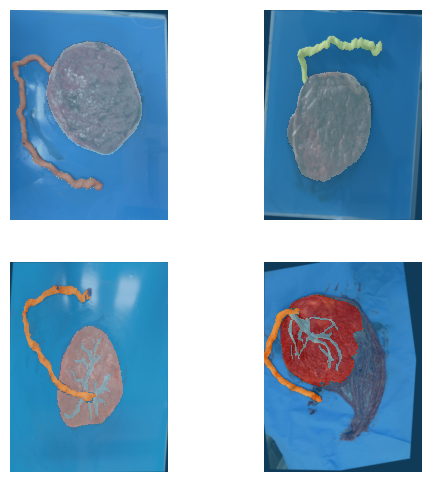

In [24]:
data.train.show_batch(max_n=6)

# Determinamos e escolhemos a learning rate

* Para isto utilizamos a função de escolha interativa de taxa de aprendizado ótima  do fastai

Downloading: "https://download.pytorch.org/models/resnet152-f82ba261.pth" to /root/.cache/torch/hub/checkpoints/resnet152-f82ba261.pth
100%|██████████| 230M/230M [00:00<00:00, 262MB/s] 


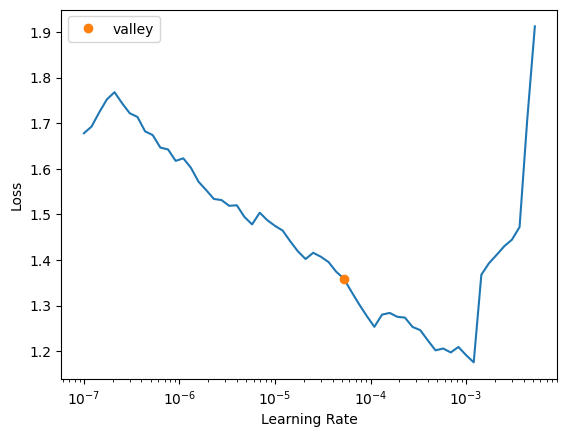

In [25]:
suggested_lr = get_learner(data).lr_find()

## Treinamos utilizando a política de adaptação simultânea de taxa de aprendizado e momento linear da rede para superconvergência 1cycle

Abaixo um explicação retirada de nosso tutorial "How to resume an interrupted training session in fastai" disponível em: https://towardsdatascience.com/how-to-resume-an-interrupted-training-session-in-fastai-77c4f36cd3a1

O método fit_one_cycle() empregado pelo fast.ai funciona com taxas e momentos de aprendizado variados e adaptativos, seguindo uma curva em que a taxa é aumentada e depois diminuída, enquanto o momento é tratado de forma oposta, conforme mostrado na figura abaixo.

![imagem](https://miro.medium.com/max/720/1*38YBWIKFwXN0YlNOVo_LOA.jpeg)

Se você interromper um treino na epoch #10 de, digamos, 20 epochs e depois recomeçar por mais 9 epochs, você não terá o mesmo resultado de treinar ininterruptamente por 20 epochs, porque um novo treino do zero, mesmo que você carregue os pesos da última época, empregarão uma nova taxa de aprendizado e política de impulso e passarão pelo ciclo novamente.

O que você quer é começar de onde você foi interrompido no ciclo.

![imagem](https://miro.medium.com/max/720/0*AzuB9-kayY2Abfp3.png)

### O que é fit1cycle?

Fit1cycle é uma política de superconvergência desenvolvida por Leslie N. Smith. Está disponível como a política de treinamento preferida no fast.ai. Veja abaixo os detalhes:

* https://docs.fast.ai/callbacks.one_cycle.html
* A disciplined approach to neural network hyper-parameters: Part 1 — learning rate, batch size, momentum, and weight decay — https://arxiv.org/abs/1803.09820
* Super-Convergence: Very Fast Training of Residual Networks Using Large Learning Rates — https://arxiv.org/abs/1708.07120

Se você quiser ver mais artigos, siga este link: Papers de Leslie N. Smith. Não entraremos em detalhes nesta postagem. Existem várias postagens no Medium apresentando e discutindo a política de treinamento fit1cycle de uma maneira fácil de ler:

* Training Neural Networks upto 10x Faster by Karanbir Chahal;
* SuperConvergence with inbuilt regularization by Yogesh Gurjar;
* Super-Convergence: Very Fast Training of Neural Networks Using Large Learning Rates by Aditya Gupta;
* Fast.ai Part1 v2/v3 Notes — Learning Rates — from SGDR to 1cycle and Super-Convergence by Roger Mao;
* Reproducing Leslie N. Smith’s papers using fastai by Kushajveer Singh.

Esta última postagem de Kushajveer Singh tem um notebook Jupyter muito ilustrativo que vale a pena olhar. Há também um artigo muito interessante de Nachiket Tanksale chamado Finding Good Learning Rate e The One Cycle Policy, onde as taxas de aprendizado cíclico e o momento são discutidos.

Leia o nosso tutorial para saber mais sobre treino em etapas e 1cycle.

# Opcional: Caso queira registrar no WandB

In [26]:
wandb.init(project='resnet')

# Realizar o primeiro treinamento

epoch,train_loss,valid_loss,acc_metric,jaccard_coeff_multi,dice_multi,time
0,0.868152,0.657920,0.179378,0.139891,0.185424,00:24
1,0.590579,0.540727,0.322280,0.183708,0.240723,00:24
2,0.466576,0.469972,0.390817,0.213345,0.271712,00:23
3,0.455424,0.558696,0.281205,0.167839,0.221032,00:24
4,0.398651,0.396457,0.472211,0.255631,0.331094,00:23
5,0.387123,0.377869,0.533008,0.281336,0.364559,00:24
6,0.375663,0.346070,0.547169,0.281350,0.360618,00:24
7,0.372016,0.394775,0.550049,0.245556,0.298036,00:23
8,0.336039,0.367660,0.585877,0.289691,0.363025,00:24
9,0.297911,0.334241,0.526017,0.296417,0.381992,00:24


Better model found at epoch 0 with dice_multi value: 0.18542447598218248.


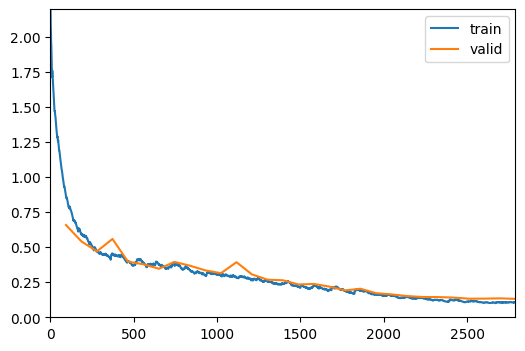

Better model found at epoch 1 with dice_multi value: 0.2407230408188096.
Better model found at epoch 2 with dice_multi value: 0.2717118482670018.
Better model found at epoch 4 with dice_multi value: 0.33109376383849476.
Better model found at epoch 5 with dice_multi value: 0.3645587007916441.
Better model found at epoch 9 with dice_multi value: 0.38199206222337223.
Better model found at epoch 10 with dice_multi value: 0.44389135361258686.
Better model found at epoch 12 with dice_multi value: 0.4782832544368823.
Better model found at epoch 13 with dice_multi value: 0.4853116809315597.
Better model found at epoch 15 with dice_multi value: 0.59379684517579.
Better model found at epoch 17 with dice_multi value: 0.6090169149678903.
Better model found at epoch 18 with dice_multi value: 0.6553329137624317.
Better model found at epoch 19 with dice_multi value: 0.6760235290271938.
Better model found at epoch 20 with dice_multi value: 0.6910356885983167.
Better model found at epoch 21 with dice_m

In [27]:
lr=suggested_lr.valley
TRAIN_EPOCH = 30
wd=1e-3
learn = get_learner(data)
callback = [SaveModelCallback(monitor='dice_multi', fname='best_model_resnet152_stg1', with_opt=True), WandbCallback(),
     ShowGraphCallback()
    ]
# Chamando learn.fit_one_cycle() ao invés de learn.fit()
learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callback)

# Mostramos imagens aleatórias do treino

Nesse imagem em específico a paleta de cores é aleatória porque utiliza uma rotina de alto nível do fastai. Nesse sentido, não é possível troca-la

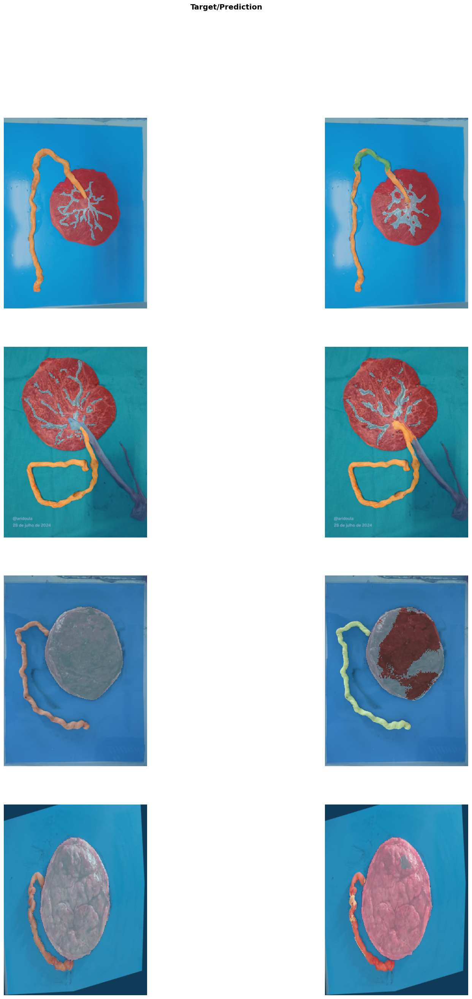

In [28]:
learn.show_results(max_n=8, figsize=(20,30))

#Escolhemos o novo learning rate a partir do treinamento anterior

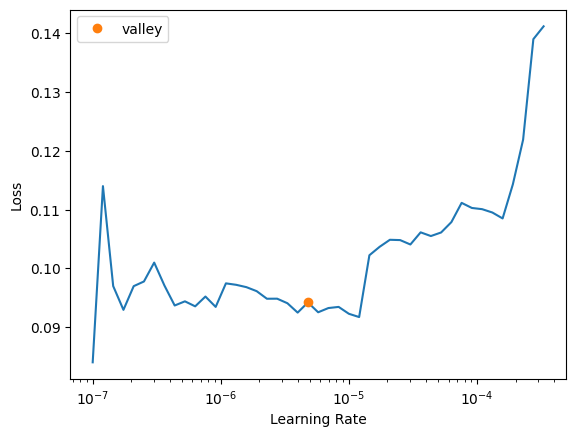

In [29]:
suggested_lr = get_learner(data, 'best_model_resnet152_stg1', True).lr_find()

epoch,train_loss,valid_loss,acc_metric,jaccard_coeff_multi,dice_multi,time
0,0.105785,0.143447,0.823201,0.646938,0.764360,00:25
1,0.102523,0.148074,0.816503,0.635967,0.755756,00:26
2,0.104311,0.143471,0.828988,0.665370,0.780831,00:26
3,0.110143,0.146450,0.822656,0.643099,0.760381,00:26
4,0.103647,0.146332,0.820869,0.653313,0.770478,00:27
5,0.102975,0.148017,0.826820,0.650098,0.765288,00:26
6,0.097470,0.146497,0.831056,0.649176,0.763492,00:26
7,0.104157,0.154060,0.826298,0.639253,0.752627,00:27
8,0.095042,0.141212,0.830908,0.660618,0.774037,00:26
9,0.098877,0.151098,0.825145,0.649437,0.763146,00:26


Better model found at epoch 0 with dice_multi value: 0.7643598505301997.


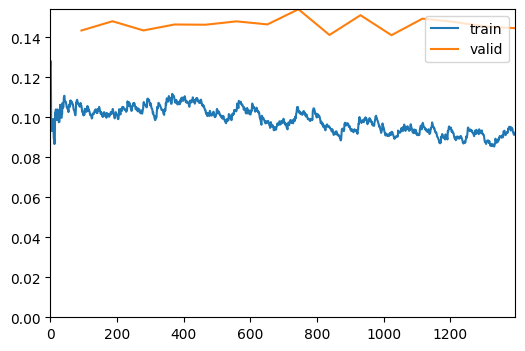

Better model found at epoch 2 with dice_multi value: 0.7808311957009102.


In [30]:
lr=slice(suggested_lr.valley)
TRAIN_EPOCH = 15
wd=1e-3
learn = get_learner(data, 'best_model_resnet152_stg1', True)
callback = [SaveModelCallback(monitor='dice_multi', fname='best_model_resnet152_stg2', with_opt=True), WandbCallback(),
     ShowGraphCallback()
    ]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callback)

# Recarregamos o Modelo caso necessário

In [31]:
learn = get_learner(data, 'best_model_resnet152_stg2')

# Numero de Imagens para display

In [32]:
n_img = 25

# Seleciona imagens aleatórias a fim de mostrar a predição da rede


Imagem, Mascara e Predição
OBS: Caso queira dar zoom na imagem, porque a plataforma não deixa

-> Botão direito do mouse na imagem, abrir imagem em outra aba.

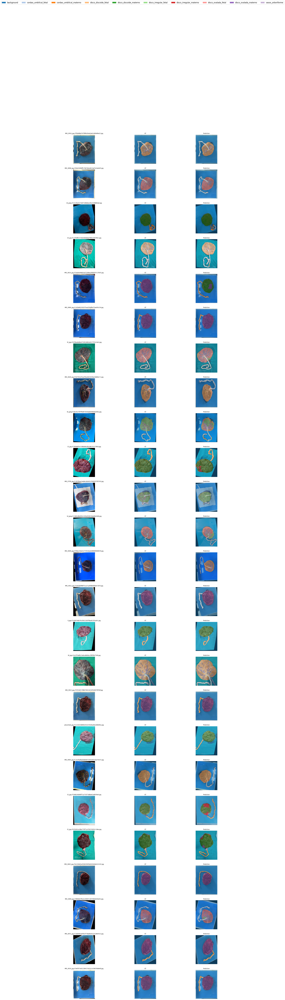

In [33]:
fig, axes = show_segmentations_dif(list(get_results(learn.predict,size,n_img)), codes, num_imgs=n_img,figSize=[20,100],mask_alpha=0.5)

## Treinamento \#2: Metade do tamanho

In [34]:
size = src_size//2
BATCH_SIZE = 4
transforms = [
  ImageResizer((size[0], size[1])),
  ToTensor(),
  IntToFloatTensor(),
  SegmentationAlbumentationsTransform(augmentations(size))
]
print(size)

[800 600]


In [35]:
data = src.dataloaders(bs=BATCH_SIZE, after_item=transforms)

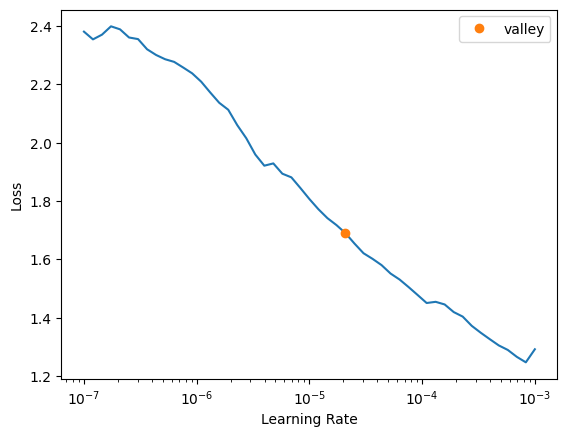

In [36]:
suggested_lr = get_learner(data).lr_find()

epoch,train_loss,valid_loss,acc_metric,jaccard_coeff_multi,dice_multi,time
0,1.164811,0.915977,0.021635,0.083544,0.101753,01:03
1,0.723525,0.605295,0.262817,0.154097,0.202723,01:04
2,0.565763,0.544369,0.270288,0.182823,0.243713,01:04
3,0.482778,0.450858,0.454283,0.240743,0.312443,01:04
4,0.422984,0.436291,0.435684,0.244584,0.327263,01:04
5,0.374781,0.373917,0.526558,0.265449,0.336975,01:04
6,0.351821,0.378758,0.414384,0.228313,0.289837,01:04
7,0.364829,0.395567,0.484822,0.265310,0.338777,01:05
8,0.321808,0.367765,0.568013,0.312031,0.404512,01:04
9,0.320359,0.381969,0.518010,0.305597,0.402415,01:04


Better model found at epoch 0 with dice_multi value: 0.10175303902017922.


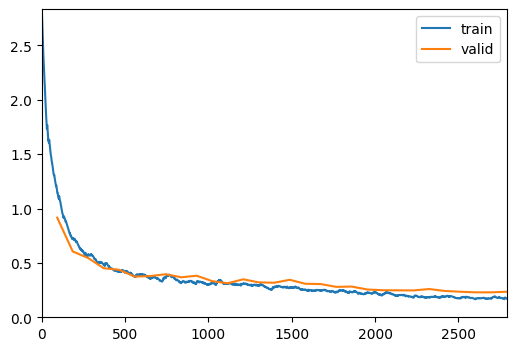

Better model found at epoch 1 with dice_multi value: 0.20272332184821948.
Better model found at epoch 2 with dice_multi value: 0.2437133448109113.
Better model found at epoch 3 with dice_multi value: 0.3124429236699234.
Better model found at epoch 4 with dice_multi value: 0.32726289078969784.
Better model found at epoch 5 with dice_multi value: 0.3369750382563688.
Better model found at epoch 7 with dice_multi value: 0.3387766883651158.
Better model found at epoch 8 with dice_multi value: 0.40451218870394834.
Better model found at epoch 12 with dice_multi value: 0.4430200729488242.
Better model found at epoch 16 with dice_multi value: 0.45980375780138283.
Better model found at epoch 17 with dice_multi value: 0.461618443022578.
Better model found at epoch 18 with dice_multi value: 0.49073517309491244.
Better model found at epoch 20 with dice_multi value: 0.515524737320268.
Better model found at epoch 21 with dice_multi value: 0.5354166506378392.
Better model found at epoch 22 with dice_m

In [37]:
lr=suggested_lr.valley
TRAIN_EPOCH = 30
wd=1e-3
learn = get_learner(data)
callback = [SaveModelCallback(monitor='dice_multi', fname='best_model_resnet152_stg1', with_opt=True), WandbCallback(),
     ShowGraphCallback()
    ]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callback)

# Escolhemos o novo learning rate a partir do treinamento anterior

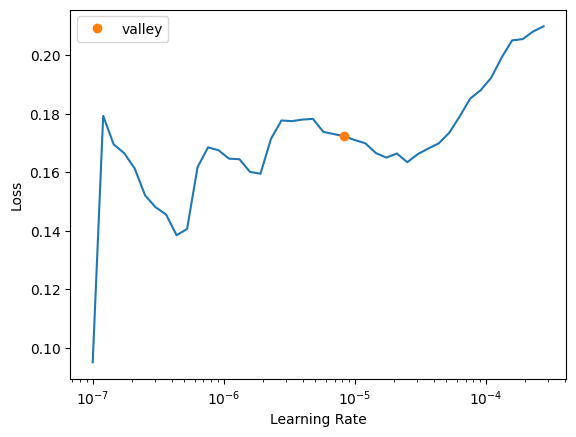

In [38]:
suggested_lr = get_learner(data, 'best_model_resnet152_stg1', True).lr_find()

epoch,train_loss,valid_loss,acc_metric,jaccard_coeff_multi,dice_multi,time
0,0.180950,0.241226,0.676446,0.468160,0.594881,01:06
1,0.195764,0.278573,0.647024,0.436749,0.562859,01:08
2,0.175787,0.257826,0.694020,0.467560,0.586274,01:07
3,0.208691,0.238441,0.679311,0.479372,0.609507,01:07
4,0.177893,0.230354,0.711681,0.509445,0.637932,01:07
5,0.172616,0.228176,0.703034,0.499189,0.638030,01:07
6,0.164275,0.209309,0.739005,0.526362,0.648406,01:07
7,0.142531,0.189247,0.768555,0.572859,0.700640,01:07
8,0.135310,0.219544,0.702567,0.529829,0.663875,01:07
9,0.139119,0.182434,0.771958,0.573310,0.699101,01:07


Better model found at epoch 0 with dice_multi value: 0.594881300708386.


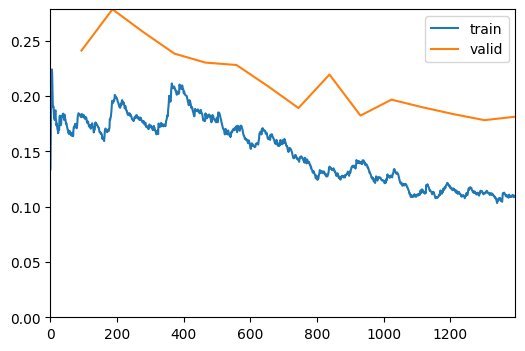

Better model found at epoch 3 with dice_multi value: 0.6095065490867551.
Better model found at epoch 4 with dice_multi value: 0.6379316150308088.
Better model found at epoch 5 with dice_multi value: 0.6380302455448802.
Better model found at epoch 6 with dice_multi value: 0.6484056279321935.
Better model found at epoch 7 with dice_multi value: 0.7006395656318546.
Better model found at epoch 11 with dice_multi value: 0.7117786397004806.
Better model found at epoch 13 with dice_multi value: 0.7184275442308361.


In [39]:
lr=suggested_lr.valley
TRAIN_EPOCH = 15
wd=1e-3
learn = get_learner(data, 'best_model_resnet152_stg1', True)
callback = [SaveModelCallback(monitor='dice_multi', fname='best_model_resnet152_stg2', with_opt=True), WandbCallback(),
     ShowGraphCallback()
    ]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callback)

# Numero de Imagens para display

In [40]:
learn = get_learner(data, 'best_model_resnet152_stg2')

In [41]:
n_img = 25

# Seleciona imagens aleatórias a fim de mostrar a predição da rede


Imagem, Mascara e Predição
OBS: Caso queira dar zoom na imagem, porque a plataforma não deixa

-> Botão direito do mouse na imagem, abrir imagem em outra aba.

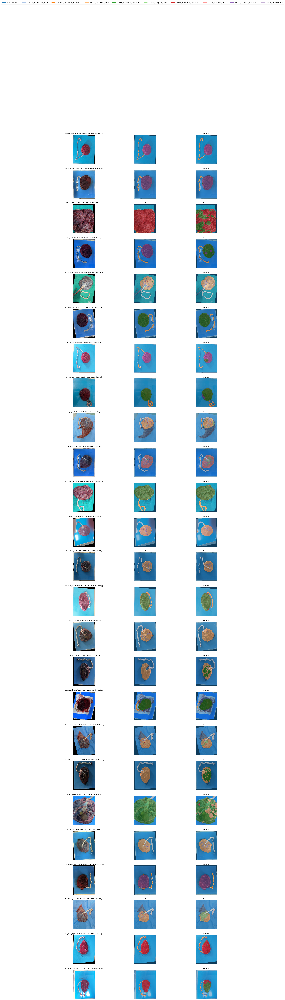

In [42]:
fig, axes = show_segmentations_dif(list(get_results(learn.predict,size,n_img)), codes, num_imgs=n_img,figSize=[20,100],mask_alpha=0.5)

## Treinamento \#3: Tamanho Inteiro

In [43]:
size = src_size
BATCH_SIZE = 2
transforms = [
  ImageResizer((size[0], size[1])),
  ToTensor(),
  IntToFloatTensor(),
  SegmentationAlbumentationsTransform(augmentations(size))
]
print(size)

[1600 1200]


In [44]:
data = src.dataloaders(bs=BATCH_SIZE, after_item=transforms)

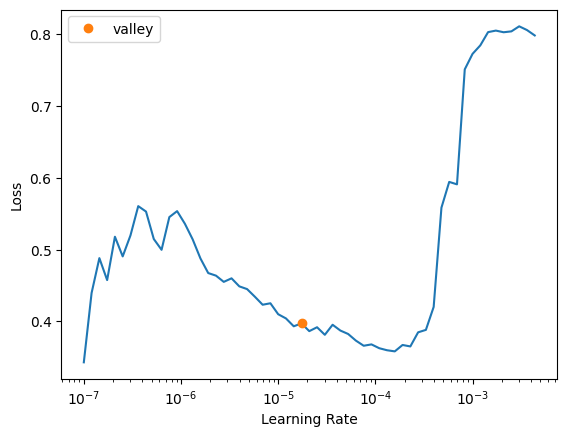

In [45]:
suggested_lr = get_learner(data,'best_model_resnet152_stg2', True).lr_find()

epoch,train_loss,valid_loss,acc_metric,jaccard_coeff_multi,dice_multi,time
0,0.885899,0.743444,0.189911,0.129840,0.166313,06:04
1,0.607978,0.604068,0.257431,0.164333,0.218244,06:09
2,0.521851,0.523512,0.383562,0.214174,0.278319,06:09
3,0.489275,0.463969,0.430543,0.229215,0.300339,06:07
4,0.435741,0.425197,0.487861,0.244520,0.309518,06:06
5,0.445528,0.451669,0.442654,0.245721,0.325010,06:07
6,0.411385,0.405240,0.552539,0.275654,0.353982,06:09
7,0.375257,0.404633,0.540549,0.268905,0.341225,06:06
8,0.388420,0.401742,0.511539,0.302885,0.404650,06:06
9,0.372526,0.383298,0.557814,0.309615,0.407827,06:06


Better model found at epoch 0 with dice_multi value: 0.1663128377466036.


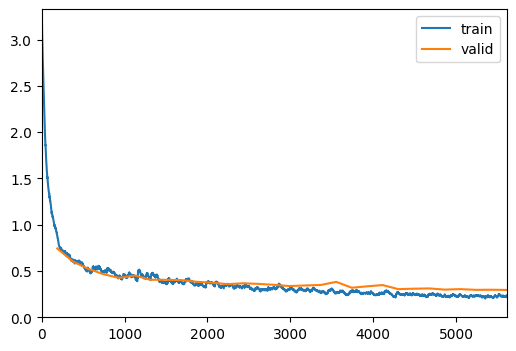

Better model found at epoch 1 with dice_multi value: 0.21824435221289948.
Better model found at epoch 2 with dice_multi value: 0.2783189863929757.
Better model found at epoch 3 with dice_multi value: 0.3003391845627675.
Better model found at epoch 4 with dice_multi value: 0.3095179804043144.
Better model found at epoch 5 with dice_multi value: 0.3250099555103691.
Better model found at epoch 6 with dice_multi value: 0.35398238529698073.
Better model found at epoch 8 with dice_multi value: 0.4046499902914409.
Better model found at epoch 9 with dice_multi value: 0.40782695170214184.
Better model found at epoch 10 with dice_multi value: 0.4245699906737589.
Better model found at epoch 14 with dice_multi value: 0.4250037468092578.
Better model found at epoch 16 with dice_multi value: 0.44390161258883243.
Better model found at epoch 19 with dice_multi value: 0.4622170940547677.
Better model found at epoch 22 with dice_multi value: 0.46594390720428985.
Better model found at epoch 23 with dice_

In [46]:
lr=suggested_lr.valley
TRAIN_EPOCH = 30
wd=1e-3
learn = get_learner(data)
callback = [SaveModelCallback(monitor='dice_multi', fname='best_model_resnet152_stg1_maxsize', with_opt=True), WandbCallback(),
     ShowGraphCallback()
    ]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callback)

# Escolhemos o novo learning rate a partir do treinamento anterior

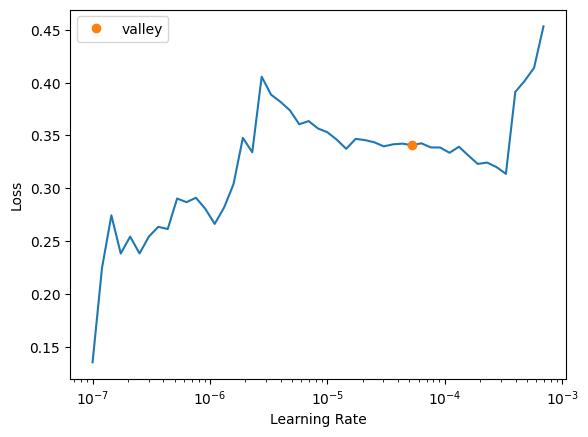

In [47]:
suggested_lr = get_learner(data, 'best_model_resnet152_stg1_maxsize', True).lr_find()

epoch,train_loss,valid_loss,acc_metric,jaccard_coeff_multi,dice_multi,time
0,0.227577,0.311417,0.638107,0.370075,0.467751,06:10
1,0.305131,0.343475,0.610936,0.338358,0.434315,06:14
2,0.321418,0.388922,0.547993,0.282039,0.350101,06:12
3,0.411306,0.392081,0.489099,0.319294,0.417261,06:11
4,0.307624,0.370449,0.537919,0.343699,0.441104,06:12
5,0.278401,0.318799,0.620052,0.372426,0.470430,06:13
6,0.244448,0.281924,0.661999,0.407298,0.500472,06:14
7,0.237939,0.287982,0.645971,0.407278,0.501444,06:12
8,0.226669,0.288993,0.600235,0.429875,0.531080,06:15
9,0.188648,0.236111,0.700602,0.487241,0.596911,06:14


Better model found at epoch 0 with dice_multi value: 0.4677510107797489.


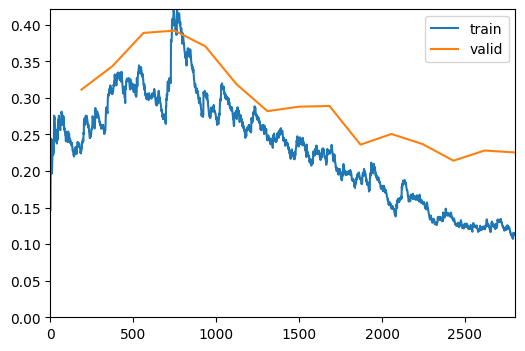

Better model found at epoch 5 with dice_multi value: 0.47042955641823936.
Better model found at epoch 6 with dice_multi value: 0.500472366850525.
Better model found at epoch 7 with dice_multi value: 0.5014436162339369.
Better model found at epoch 8 with dice_multi value: 0.5310795347811067.
Better model found at epoch 9 with dice_multi value: 0.5969114050111681.
Better model found at epoch 10 with dice_multi value: 0.6080144997315549.
Better model found at epoch 11 with dice_multi value: 0.6243974420227602.
Better model found at epoch 12 with dice_multi value: 0.6336279500195267.
Better model found at epoch 13 with dice_multi value: 0.6341630949245207.
Better model found at epoch 14 with dice_multi value: 0.6385875390898436.


In [48]:
lr=suggested_lr.valley
TRAIN_EPOCH = 15
wd=1e-3
learn = get_learner(data, 'best_model_resnet152_stg1_maxsize', True)
callback = [SaveModelCallback(monitor='dice_multi', fname='best_model_resnet152_stg2_maxsize', with_opt=True), WandbCallback(),
     ShowGraphCallback()
    ]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callback)

# Recarregamos o Modelo caso necessário

In [49]:
learn = get_learner(data, 'best_model_resnet152_stg2_maxsize')

# Numero de Imagens para display

In [50]:
n_img = 25

# Seleciona imagens aleatórias a fim de mostrar a predição da rede


Imagem, Mascara e Predição
OBS: Caso queira dar zoom na imagem, porque a plataforma não deixa

-> Botão direito do mouse na imagem, abrir imagem em outra aba.

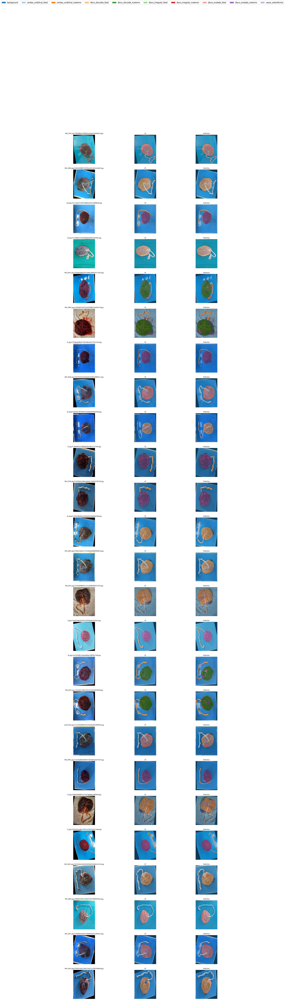

In [51]:
fig, axes = show_segmentations_dif(list(get_results(learn.predict,size,n_img)), codes, num_imgs=n_img,figSize=[20,100],mask_alpha=0.5)

# Evaluation

In [52]:
from lapixdl.evaluation.evaluate import evaluate_segmentation

def gt_mask_iterator_from_image_files(fnames, size):
  for fname in fnames:
    yield np.array(PILMask.create(get_mask(fname)).resize((size[1], size[0])))

def pred_mask_iterator_from_image_files(fnames, size, predict):
  for fname in fnames:
    res = predict(fname)
    yield np.array(res[0])

# Definimos o Path e modelo de rede para testar as imagens destinadas a teste
Setamos o path do teste e o tamanho das imagens para igualar com o modelo.

In [ ]:
size = src_size

test_image_files = get_image_files(os.path.join(path_img,'test'))
transforms = [
  ImageResizer((size[0], size[1])),
  ToTensor(),
  IntToFloatTensor()
]

tfms = [[PILImage.create], [get_mask, PILMask.create, AddMaskCodes(codes)]]
src = Datasets(test_image_files, tfms)
test_dl = src.dataloaders(bs=1, after_item=transforms)

learn = get_learner(test_dl, 'best_model_resnet152_stg2_maxsize')

gt_masks = gt_mask_iterator_from_image_files(test_image_files, size)
pred_masks = pred_mask_iterator_from_image_files(test_image_files, size, learn.predict)

# Avaliamos os resultados utilizando as métricas pré estabelecidas
Chamamos a função eveluate_segmentation importada da biblioteca do Lapix, passando as máscaras originais, máscaras previstas e o codes, nesse sentido, será criada a matriz de confusão

0 masks [00:00, ? masks/s]

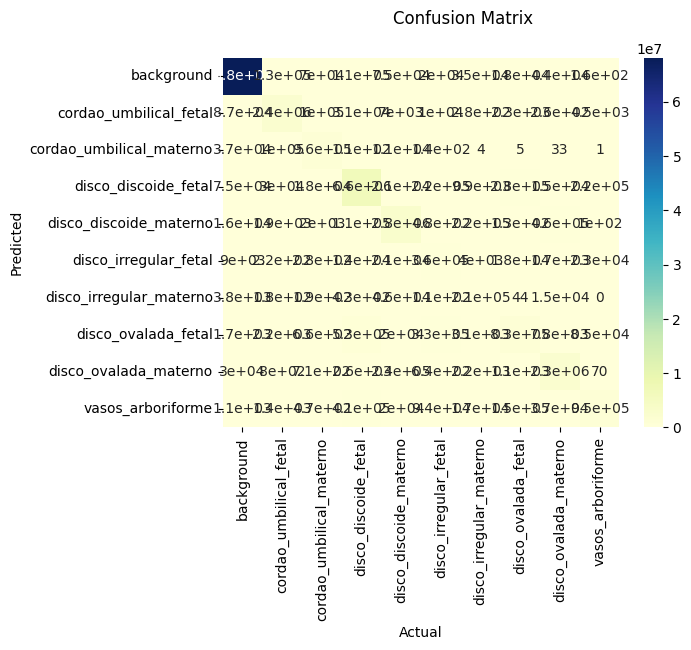

(<Figure size 640x480 with 2 Axes>,
 <Axes: xlabel='Actual', ylabel='Predicted'>)

In [ ]:
eval = evaluate_segmentation(gt_masks, pred_masks, codes)
eval.show_confusion_matrix()

In [ ]:
interp = SegmentationInterpretation.from_learner(learn, dl=test_dl[0])

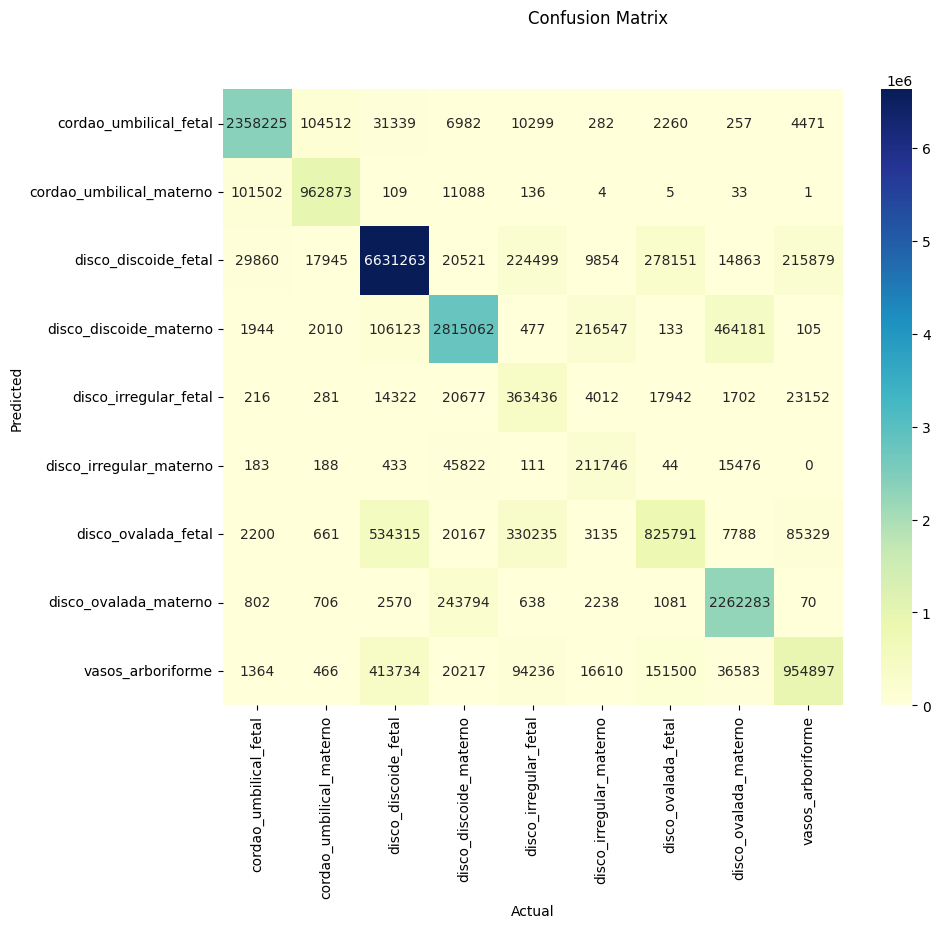

In [ ]:
interp = SegmentationInterpretation.from_learner(learn, dl=test_dl[0])

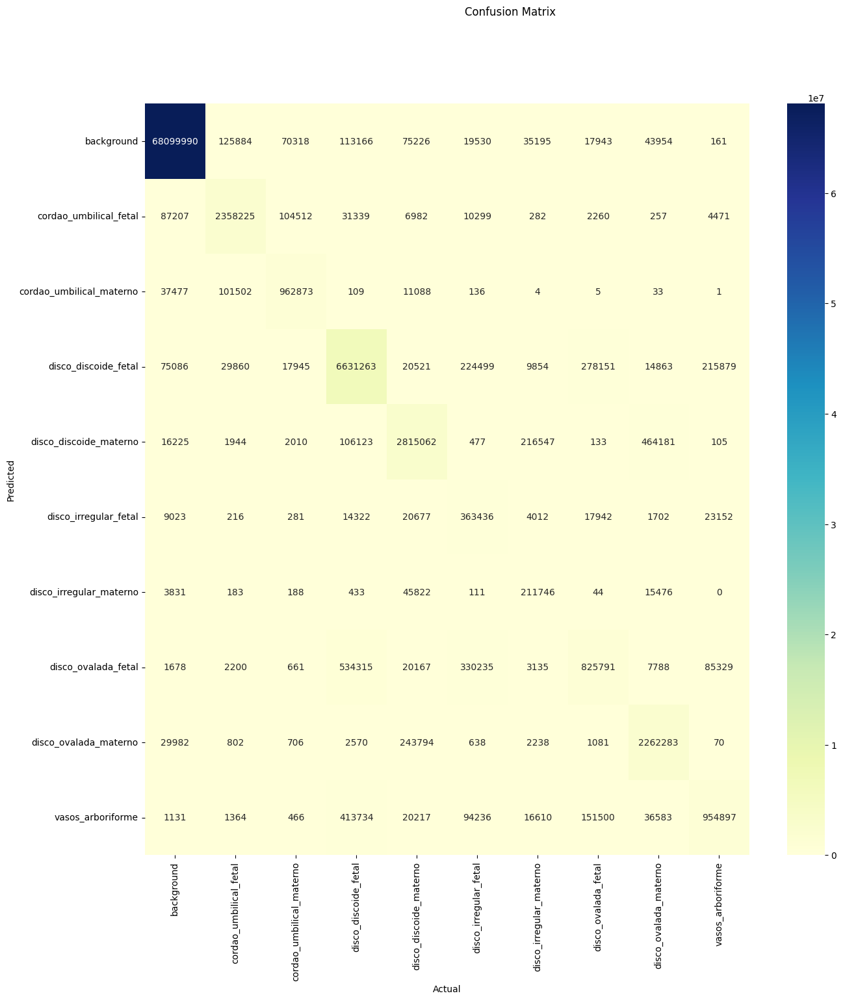

In [ ]:
import pandas as pd
import seaborn as sn
import numpy as np
import os

df_cm = pd.DataFrame(eval.confusion_matrix, codes, codes)
fig, ax = plt.subplots()
fig.suptitle("Confusion Matrix")
fig.set_figheight(15)
fig.set_figwidth(15)
ax = sn.heatmap(df_cm, annot=True, ax=ax, cmap='YlGnBu',  fmt='d')
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')
plt.show()

# Verificamos os piores casos

Nesse imagem em específico a paleta de cores é aleatória porque utiliza uma rotina de alto nível do fastai. Nesse sentido, não é possível troca-la

Obs: Pode mudar o valor "6" para se obter mais ou menos imagens

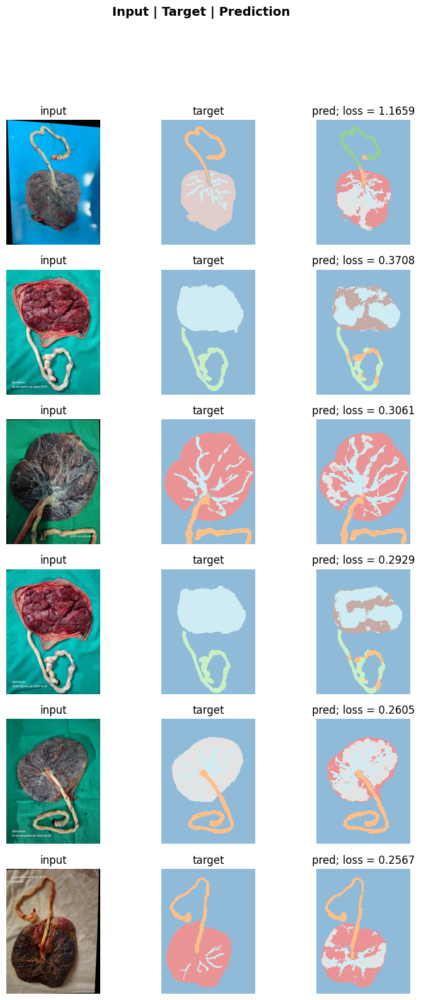

In [ ]:
interp.plot_top_losses(k=6)